In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from altair import Chart

In [2]:
data = pd.read_csv('train_sample.csv')

In [3]:
data.head()

,ip,app,device,os,channel,click_time,attributed_time,is_attributed
0,87540,12,1,13,497,2017-11-07 09:30:38,NaN,0
1,105560,25,1,17,259,2017-11-07 13:40:27,NaN,0
2,101424,12,1,19,212,2017-11-07 18:05:24,NaN,0
3,94584,13,1,13,477,2017-11-07 04:58:08,NaN,0
4,68413,12,1,1,178,2017-11-09 09:00:09,NaN,0


Lets take a look at the data and see if there any interesting correlations

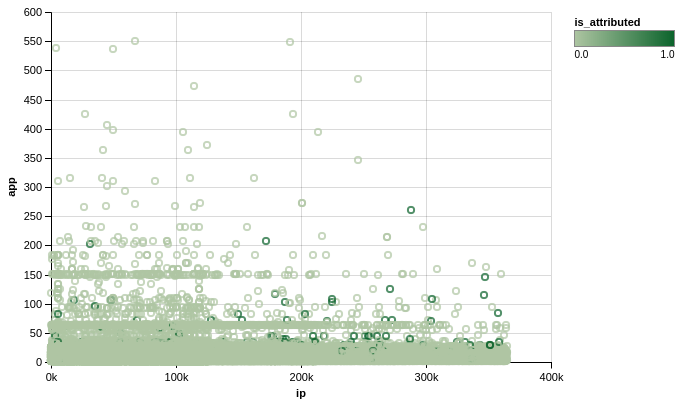

In [4]:
Chart(data, max_rows=1000000).mark_point().encode(
    x='ip',
    y='app',
    color='is_attributed'
)

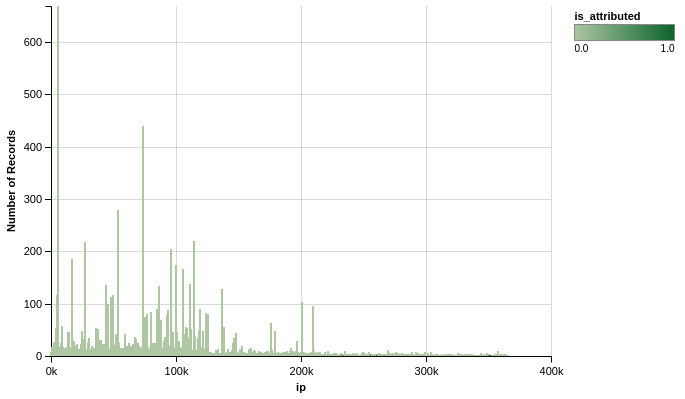

In [6]:
Chart(data, max_rows=1000000).mark_bar().encode(
    x='ip',
    y='count(*)',
    color='is_attributed'
)

Two interesting things to note here:

First, it seems that some apps in which an ad is served are more likely to have clicks that actually lead to a download, though unfortunately those apps also have more generated clicks. Second, it appears that there are a number of ips that produce an indordinate amount of clicks. Let's see how that compares to the median.

In [8]:
data[['ip', 'device']].groupby('ip').count().median()

device    2.0
dtype: float64

It looks like there's a pretty big difference in the number of clicks between the average clicker and some of those ips. Perhaps some filtering would be in order, since the big clickers are likely bots.

In [9]:
filtered = data[data['ip'].isin(data.groupby('ip').count().query("device < 11").index)]
filtered.head()

,ip,app,device,os,channel,click_time,attributed_time,is_attributed
0,87540,12,1,13,497,2017-11-07 09:30:38,NaN,0
2,101424,12,1,19,212,2017-11-07 18:05:24,NaN,0
3,94584,13,1,13,477,2017-11-07 04:58:08,NaN,0
4,68413,12,1,1,178,2017-11-09 09:00:09,NaN,0
5,93663,3,1,17,115,2017-11-09 01:22:13,NaN,0


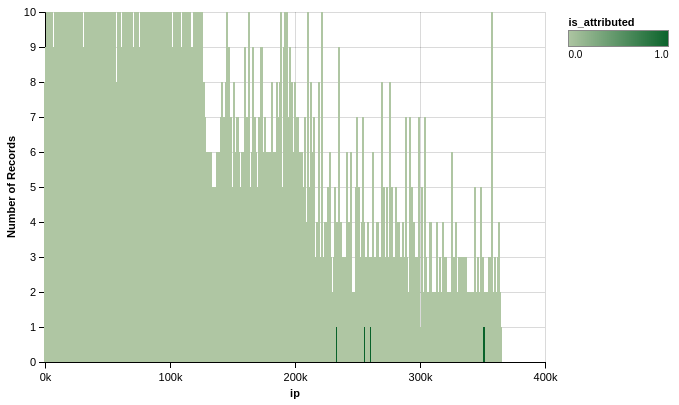

In [10]:
Chart(filtered, max_rows=1000000).mark_bar().encode(
    x='ip',
    y='count(*)',
    color='is_attributed'
)

In [11]:
print(len(filtered.query("is_attributed == 1")))
print(len(data.query("is_attributed == 1")))

205
227


In [12]:
for col_name in ['app', 'device', 'os', 'channel']:
    encoded = pd.get_dummies(filtered[col_name])
    new_labels = [col_name + str(num) for num in encoded.columns]
    encoded.columns = new_labels
    filtered.drop(['app', 'device', 'os', 'channel'], axis='columns')
    filtered = filtered.join(encoded)

In [13]:
filtered.head()

,ip,app,device,os,channel,click_time,attributed_time,is_attributed,app1,app2,...,channel483,channel484,channel486,channel487,channel488,channel489,channel490,channel496,channel497,channel498
0,87540,12,1,13,497,2017-11-07 09:30:38,NaN,0,0,0,...,0,0,0,0,0,0,0,0,1,0
2,101424,12,1,19,212,2017-11-07 18:05:24,NaN,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,94584,13,1,13,477,2017-11-07 04:58:08,NaN,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,68413,12,1,1,178,2017-11-09 09:00:09,NaN,0,0,0,...,0,0,0,0,0,0,0,0,0,0
5,93663,3,1,17,115,2017-11-09 01:22:13,NaN,0,0,0,...,0,0,0,0,0,0,0,0,0,0
